# Exploring the prompts

General rules for a good prompt:

* A good prompt should be at least three words long for a clear context. The more words you use, the easier it will be for the generator to understand the context of the image you are looking for.

* Adjectives are very important in prompt engineering because they infuse feelings into your work, making it more realistic and "alive". Try to include multiple adjectives in your prompts.

* You need to use a particular style when creating prompts. Some popular examples: realism, minimalism, surrealism, symmetry, modern, etc.

* Do not use vulgar or prohibited words in your text prompts to avoid problems, remember to comply with the license.


In [1]:
!pip install torch==2.1.0+cu121 torchvision==0.16.0+cu121 torchaudio==2.1.0 torchtext==0.16.0+cpu torchdata==0.7.0 --index-url https://download.pytorch.org/whl/cu121

Looking in indexes: https://download.pytorch.org/whl/cu121
  Using cached https://download.pytorch.org/whl/cu121/torch-2.1.0%2Bcu121-cp310-cp310-linux_x86_64.whl (2200.6 MB)
  Using cached https://download.pytorch.org/whl/triton-2.1.0-0-cp310-cp310-manylinux2014_x86_64.manylinux_2_17_x86_64.whl (89.2 MB)
  Attempting uninstall: triton
    Found existing installation: triton 3.0.0
    Uninstalling triton-3.0.0:
      Successfully uninstalled triton-3.0.0
  Attempting uninstall: torch
    Found existing installation: torch 2.4.0
    Uninstalling torch-2.4.0:
      Successfully uninstalled torch-2.4.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
xformers 0.0.27.post2 requires torch==2.4.0, but you have torch 2.1.0+cu121 which is incompatible.

[notice] A new release of pip is available: 24.1.2 -> 24.2
[notice] To update, run: pip install --upgrade pip


In [2]:
!pip install diffusers


[notice] A new release of pip is available: 24.1.2 -> 24.2
[notice] To update, run: pip install --upgrade pip


In [3]:
!pip install -q accelerate transformers ftfy bitsandbytes natsort safetensors xformers


ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchaudio 2.1.0+cu121 requires torch==2.1.0, but you have torch 2.4.0 which is incompatible.
torchdata 0.7.0 requires torch==2.1.0, but you have torch 2.4.0 which is incompatible.
torchtext 0.16.0+cpu requires torch==2.1.0, but you have torch 2.4.0 which is incompatible.
torchvision 0.16.0+cu121 requires torch==2.1.0, but you have torch 2.4.0 which is incompatible.

[notice] A new release of pip is available: 24.1.2 -> 24.2
[notice] To update, run: pip install --upgrade pip


In [4]:
import torch
from diffusers import StableDiffusionPipeline

/opt/conda/lib/python3.10/site-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: '/opt/conda/lib/python3.10/site-packages/torchvision/image.so: undefined symbol: _ZN3c1017RegisterOperatorsD1Ev'If you don't plan on using image functionality from `torchvision.io`, you can ignore this warning. Otherwise, there might be something wrong with your environment. Did you have `libjpeg` or `libpng` installed before building `torchvision` from source?
  warn(
2024-08-09 07:50:52.123931: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-08-09 07:51:19.917508: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
/opt/conda/lib/python3.10/site-packages/xformers/ops/fmha/flash.

In [5]:
pipe = StableDiffusionPipeline.from_pretrained("runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16)
pipe = pipe.to("cuda")

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


In [6]:
pipe.enable_attention_slicing()
pipe.enable_xformers_memory_efficient_attention()

In [7]:
seed = 777

In [8]:
from PIL import Image

def grid_img(imgs, rows=1, cols=3, scale=1):
  assert len(imgs) == rows * cols

  w, h = imgs[0].size
  w, h = int(w*scale), int(h*scale)

  grid = Image.new('RGB', size=(cols*w, rows*h))
  grid_w, grid_h = grid.size

  for i, img in enumerate(imgs):
      img = img.resize((w,h), Image.ANTIALIAS)
      grid.paste(img, box=(i%cols*w, i//cols*h))
  return grid

### Subject / object

- The subject/object is what you want to see in the image.
- A common mistake is not writing enough about the subjects, which leaves too much room for imagination. How do you want it to look? Any words to describe? What is wearing?
- We have to say (write) exactly what we want.
- A common trick is using celebrity names. It has a strong effect to control appearance.

  0%|          | 0/50 [00:00<?, ?it/s]

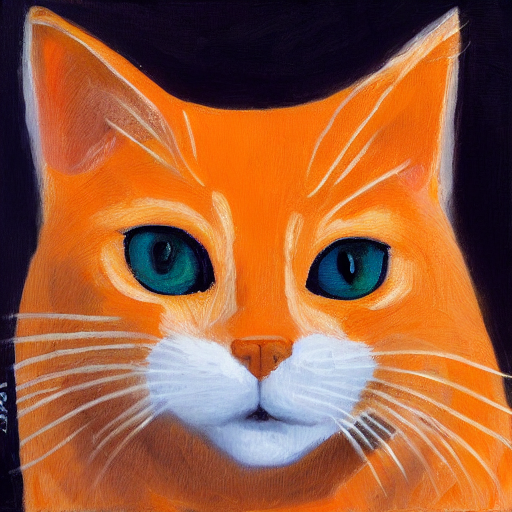

In [9]:
prompt = 'an orange cat'

generator = torch.Generator('cuda').manual_seed(seed)
img = pipe(prompt, generator=generator).images[0]
img

### Action and location

- What is doing? What is wearing? Is it on foot, running or floating in the air? How is the background?

  0%|          | 0/50 [00:00<?, ?it/s]

/tmp/ipykernel_2370/3260908514.py:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w,h), Image.ANTIALIAS)


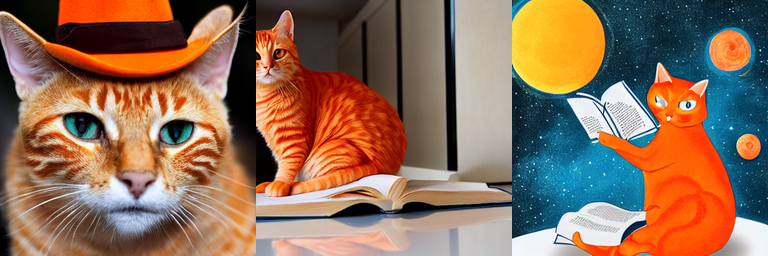

In [10]:
prompt = ['an orange cat wearing a hat',
          'an orange cat reading a book in the kitchen',
          'an orange cat reading a book in space']

generator = torch.Generator('cuda').manual_seed(seed)
imgs = pipe(prompt, generator=generator).images

grid = grid_img(imgs, rows=1, cols=len(prompt), scale=0.5)
grid

### Type

- It is the material used to make the image or artwork. Some examples: illustration, photography, oil painting, 3D rendering.
- A single keyword can drastically change the style.

  0%|          | 0/50 [00:00<?, ?it/s]

/tmp/ipykernel_2370/3260908514.py:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w,h), Image.ANTIALIAS)


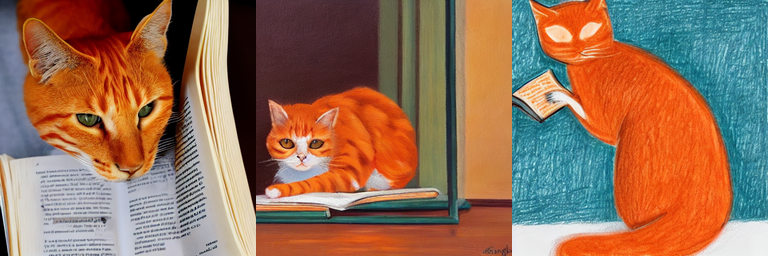

In [11]:
prompt = ["photo of an orange cat reading a book in the kitchen",
          "oil painting of an orange cat reading a book in the kitchen",
          "drawing of an orange cat reading a book in the kitchen"]

generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompt, generator=generator).images

grid = grid_img(imgs, rows=1, cols=len(prompt), scale=0.5)
grid

#### Useful keywords

> `Painting, Photo, Drawing, 3D rendering`, etc

> More specifics: `Oil painting, watercolor painting, Portrait, Sketch, Digital painting, Concept art, Ultra realistic illustration, Underwater portrait, Underwater steampunk`

['orange cat reading a book in space, oil painting', 'orange cat reading a book in space, digital painting', 'orange cat reading a book in space, underwater steampunk']


  0%|          | 0/50 [00:00<?, ?it/s]

/tmp/ipykernel_2370/3260908514.py:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w,h), Image.ANTIALIAS)


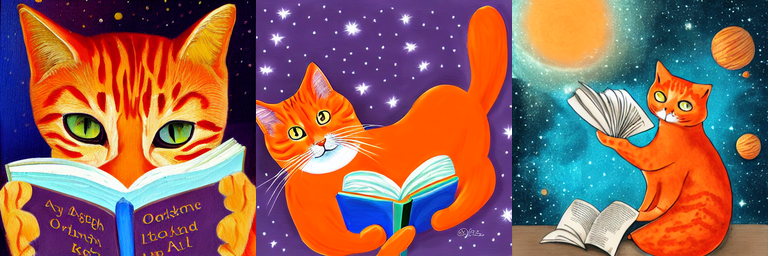

In [12]:
base = 'orange cat reading a book in space'

m_ = [', oil painting',
      ', digital painting',
      ', underwater steampunk']

prompts = []

for m in m_:
  prompts.append(base + m)

print(prompts)

generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompts, generator=generator).images

grid = grid_img(imgs, rows=1, cols=len(prompts), scale=0.5)
grid

### Style

- It is the artistic style of the image.
- Examples: impressionist, surrealist, pop art, etc.
- Sometimes you don't notice much difference if you add more specific terms. This can especially happen in cases where the effect of the keywords used was already implied by the previously used terms, such as the type or artist names.

['orange cat reading a book in space, Modernist', 'orange cat reading a book in space, impressionist', 'orange cat reading a book in space, realistic']


  0%|          | 0/50 [00:00<?, ?it/s]

/tmp/ipykernel_2370/3260908514.py:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w,h), Image.ANTIALIAS)


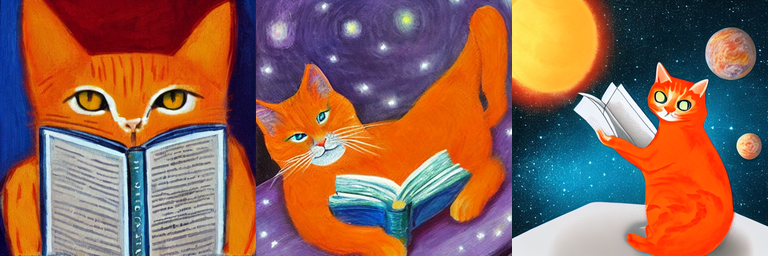

In [13]:
base = "orange cat reading a book in space"

m_ = [", Modernist",
      ", impressionist",
      ", realistic"]

prompts = []

for m in m_:
  prompts.append(base + m)

print(prompts)

generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompts, generator=generator).images

grid = grid_img(imgs, rows=1, cols=len(prompts), scale=0.5)
grid

#### Useful keywords

> `realistic, hyperrealistic, pop-art, modernist, art nouveau, surrealist`, etc.

### Colors

- You can control the overall color of the image by adding color or hue keywords.
- For example, if we want to add a little golden color to the image we can use the term `gold` or even "iridescent gold", which will give a very shiny golden tone

['a photograph of an orange cat reading a book in space, realistic, purple', 'a photograph of an orange cat reading a book in space, realistic, red colors', 'a photograph of an orange cat reading a book in space, realistic, black and white']


  0%|          | 0/50 [00:00<?, ?it/s]

/tmp/ipykernel_2370/3260908514.py:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w,h), Image.ANTIALIAS)


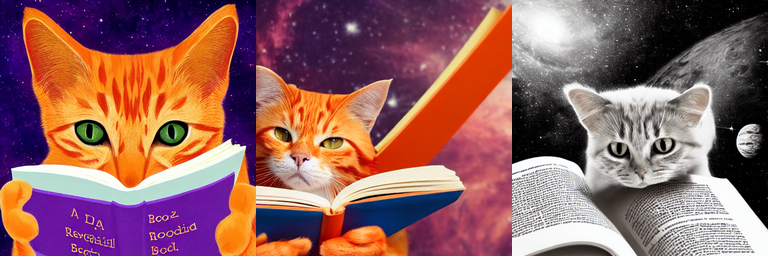

In [14]:
base = "a photograph of an orange cat reading a book in space, realistic"

m_ = [", purple",
      ", red colors",
      ", black and white"]

prompts = []

for m in m_:
  prompts.append(base + m)

print(prompts)

generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompts, generator=generator).images

grid = grid_img(imgs, rows=1, cols=len(prompts), scale=0.5)
grid

#### Useful keywords

> `vivid`, `tones` or `colors`, `bw` (black and white),`vintage`, `gold`, `silver`, etc.

### Artist

Adding the name of well-known artists can strongly influence the image. It allows you to use the style of a specific artist.

- It is also possible to use multiple artist names to mix their styles. For example, if we are generating an image of a person and want a more unique and artistic aesthetic, we can add the term Alphonse Mucha, a portrait painter from the 19th century.
- The names of artists work best for paintings, but if you want, you can try with other media to see the result. If you want to generate photos related to photography, then you could try to put names of famous photographers, so the image would have that style.
- Adding the names of artists who are best known for portraits of people may only work well if the subject is a person, as the model has been trained with images of that type of subject.
- You do not need to add the words "by" or "painted by"

['a painting of an orange cat reading a book in space, realistic, by Van Gogh', 'a painting of an orange cat reading a book in space, realistic, by Sandro Botticelli', 'a painting of an orange cat reading a book in space, realistic, by Monet', 'a painting of an orange cat reading a book in space, realistic, by Da Vinci']


  0%|          | 0/50 [00:00<?, ?it/s]

/tmp/ipykernel_2370/3260908514.py:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w,h), Image.ANTIALIAS)


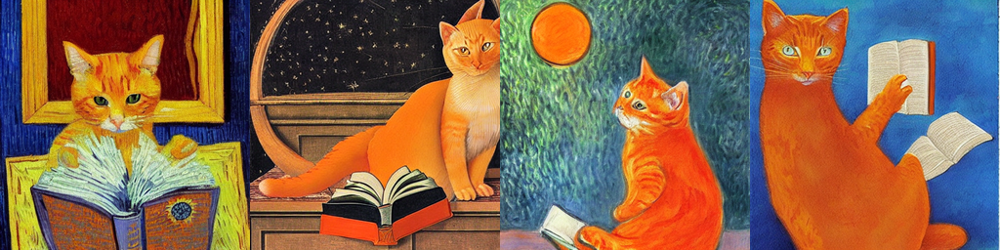

In [15]:
base = "a painting of an orange cat reading a book in space, realistic"

m_ = [", by Van Gogh",
      ", by Sandro Botticelli",
      ", by Monet",
      ", by Da Vinci"]

prompts = []

for m in m_:
  prompts.append(base + m)

print(prompts)

generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompts, generator=generator).images

grid = grid_img(imgs, rows=1, cols=len(prompts), scale=0.5)
grid

#### Useful keywords

> `Van Gogh`, `John Collier`, `Monet`, `Alphonse Mucha`, `Salvador Dali`, `Rembrandt`, `Da Vinci`, etc.

> List of artists available in Stable Diffusion: https://www.urania.ai/top-sd-artists

### Resolution

- It represents how sharp and detailed the image will be. For example, we can add `highly detailed` and `sharp focus` keywords. On the other hand, if we want a blurred image or a motion/blur effect we can use the keyword `blurred`

['a futuristic city on another planet at dawn, unreal engine', 'a futuristic city on another planet at dawn, sharp focus', 'a futuristic city on another planet at dawn, vray']


  0%|          | 0/50 [00:00<?, ?it/s]

/tmp/ipykernel_2370/3260908514.py:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w,h), Image.ANTIALIAS)


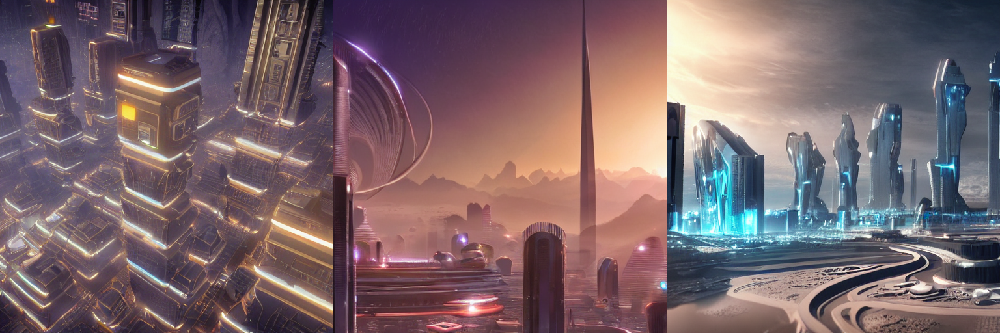

In [16]:
base = "a futuristic city on another planet at dawn"

m_ = [", unreal engine",
      ", sharp focus",
      ", vray"]

prompts = []

for m in m_:
  prompts.append(base + m)

print(prompts)

generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompts, generator=generator).images

grid = grid_img(imgs, rows=1, cols=len(prompts))
grid

#### Useful keywords

> `highly detailed`, `unreal engine` (detailed and realistic 3D), `sharp focus`, `hd`, `4k` or `8k`, `vray` (3D renderizations - good results for landscapes)

### Site

- Websites specialized in images
- Examples: `pixabay`, `unsplash`

['an orange cat reading a book in space, realistic, unsplash', 'an orange cat reading a book in space, realistic, pixabay', 'an orange cat reading a book in space, realistic, pixiv']


  0%|          | 0/50 [00:00<?, ?it/s]

/tmp/ipykernel_2370/3260908514.py:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w,h), Image.ANTIALIAS)


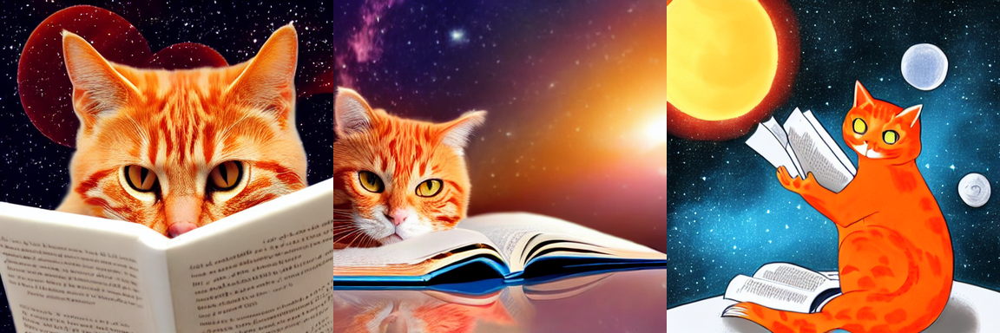

In [17]:
base = "an orange cat reading a book in space, realistic"

m_ = [", unsplash",
      ", pixabay",
      ", pixiv"]

prompts = []

for m in m_:
  prompts.append(base + m)

print(prompts)

generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompts, generator=generator).images

grid = grid_img(imgs, rows=1, cols=len(prompts), scale=0.75)
grid

#### Useful keywords

> `artstation` (art and design), `pixabay`, `unsplash`, `pexels`, `pixiv` (Japanese virtual community. It will return anime-style images)

### Other attributes

- Exampless: `sci-fi`, `stunningly beautiful`, `dystopian`, `dramatic` (it tends to increase emotional expressiveness in the face).



#### Ilumination

['photograph of an orange cat reading a book in space, realistic, unsplash, cinematic lighting', 'photograph of an orange cat reading a book in space, realistic, unsplash, rim lighting', 'photograph of an orange cat reading a book in space, realistic, unsplash, sunset']


  0%|          | 0/50 [00:00<?, ?it/s]

/tmp/ipykernel_2370/3260908514.py:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w,h), Image.ANTIALIAS)


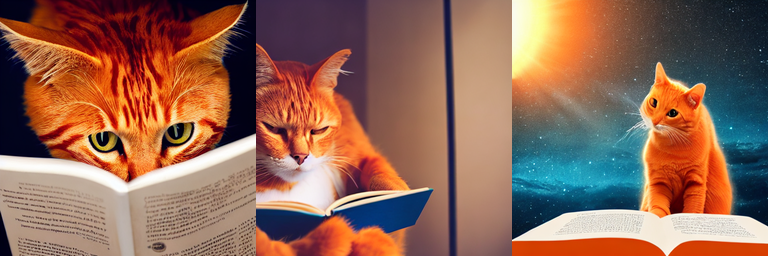

In [18]:
base = "photograph of an orange cat reading a book in space, realistic, unsplash"

m_ = [", cinematic lighting",
      ", rim lighting",
      ", sunset"]

prompts = []

for m in m_:
  prompts.append(base + m)

print(prompts)

generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompts, generator=generator).images

grid = grid_img(imgs, rows=1, cols=len(prompts), scale=0.5)
grid

#### Others

['photo of an orange cat reading a book in space, realistic, unsplash, stunningly beautiful, award winning photo, tilt-shift', 'photo of an orange cat reading a book in space, realistic, dramatic', 'photo of an orange cat reading a book in space, realistic, low angle shot']


  0%|          | 0/50 [00:00<?, ?it/s]

/tmp/ipykernel_2370/3260908514.py:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w,h), Image.ANTIALIAS)


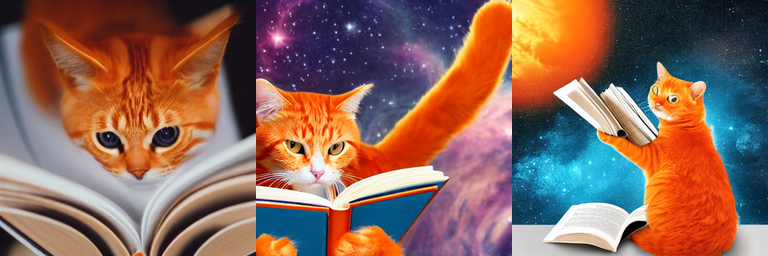

In [19]:
base = "photo of an orange cat reading a book in space, realistic"

m_ = [", unsplash, stunningly beautiful, award winning photo, tilt-shift",
      ", dramatic",
      ", low angle shot"]

prompts = []

for m in m_:
  prompts.append(base + m)

print(prompts)

generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompts, generator=generator).images

grid = grid_img(imgs, rows=1, cols=len(prompts), scale=0.5)
grid

#### Useful keywords


> Ilumination: `cinematic lighting`, `rim lighting`, `natural light`, `side light`, `sunset` or `golden hour`

> Change the vibe: `dramatic`, `sci-fi`, `dystopian`.

> Add more aesthetics:  `stunningly beautiful`, `award winning photo`, `masterpiece`.

> Terms associated with photography (camera millimeter): `35mm`, `50mm`, `80mm`, `85mm`, `wide angle`, `analog`, `fisheye lens`, `gopro`, `dslr`, `film`, `tilt-shift`.

> others: `blurred background`, `psychodelic`, `low angle shot`, `frontal face`, `expansive`, `detailed clothing`


---

> **Comments:**

- Some images look really good with just a few keywords. You often don't need to have a lot of keywords to get good images.
- If more terms are added you may get worse results. It is as if some terms generate more unnecessary "noise" to the images
- Just because you are using a keyword it doesn't mean it is effective.
- CLIP can handle 77 tokens
- The result does not depend only on the prompt, but also it depends on the parameters

## Negative prompts


  0%|          | 0/50 [00:00<?, ?it/s]

/tmp/ipykernel_2370/3260908514.py:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w,h), Image.ANTIALIAS)


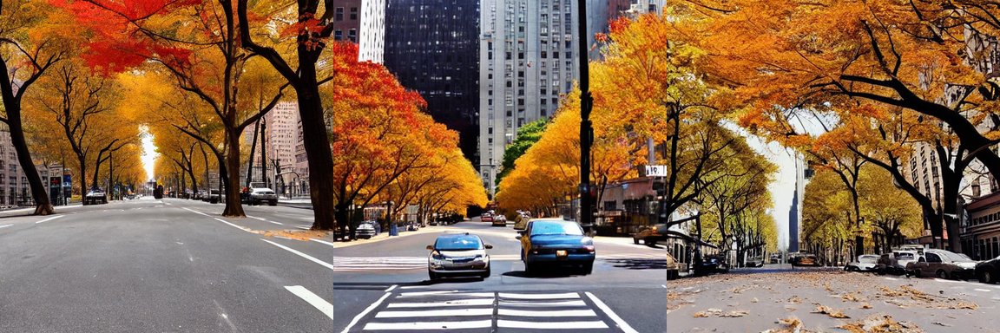

In [20]:
prompt = "photo of autumn in new york without cars"
num_imgs = 3

imgs = pipe(prompt,
             num_images_per_prompt=num_imgs,
             generator=torch.Generator("cuda").manual_seed(seed)).images

grid = grid_img(imgs, rows=1, cols=num_imgs, scale=0.75)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

/tmp/ipykernel_2370/3260908514.py:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w,h), Image.ANTIALIAS)


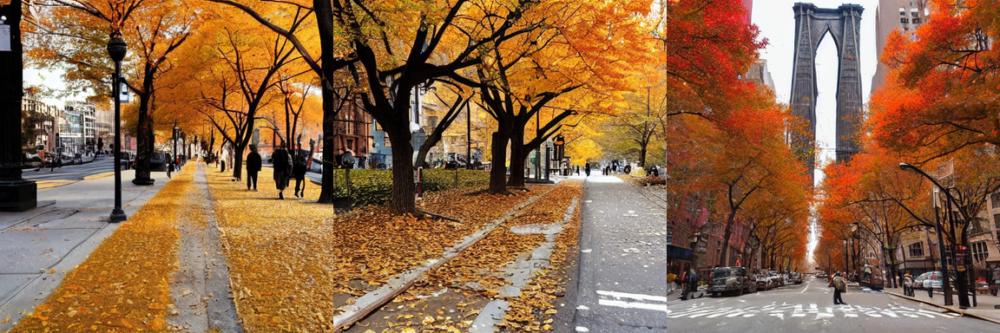

In [21]:
prompt = "photo of autumn in new york without cars"
neg_prompt = "cars"
num_imgs = 3

imgs = pipe(prompt,
             num_images_per_prompt=num_imgs,
             negative_prompt = neg_prompt).images

grid = grid_img(imgs, rows=1, cols=num_imgs, scale=0.75)
grid

### Useful negative prompts

* **Defects in anatomy generation** - distorted body parts.
  * general examples: `bad anatomy, ugly, distorted face, deformed, desfigured, extra limbs`  
  * for badly drawn body parts: `poorly drawn hands, poorly drawn face, poorly drawn feet`

* **Improve resolution/definition** - remove blur or low definition
  * examples: `blurry, low quality, low definition, lowres`
  * if you want to improve the quality of an already generated image then what you are looking for is a super-resolution technique (*upscale*).

* **Object/subject partially out of frame** - object placement on the edges of the image
  * `out of frame, out of image, cropped, cut off`

* **Avoid adding signatures** - remove watermarks
  * Examples: `signature, watermark`

* **Contrast or brightness adjustment**  
`low contrast`, `underexposed`, `overexposed`

* For example, when you use the "photograph" keyword and the images are still coming out with a certain painting look, so you can add the term "painting" or "drawing" to the negative prompt to indicate that we want to avoid it.

### Universal negative prompt

> `bad anatomy, ugly, deformed, desfigured, distorted face, poorly drawn hands, poorly drawn face, poorly drawn feet`

  0%|          | 0/50 [00:00<?, ?it/s]

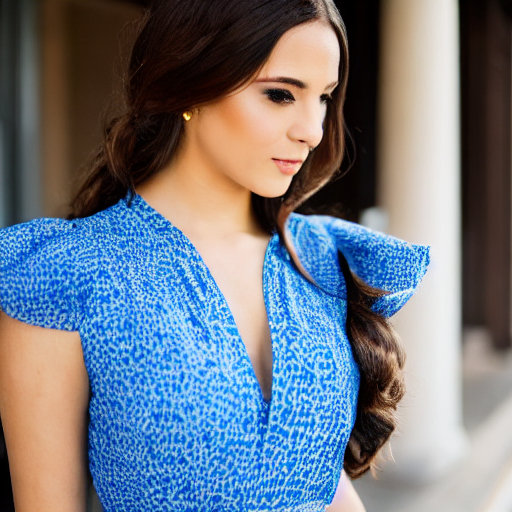

In [22]:
prompt = "a young woman, front face, wearing a blue dress, natural light"
neg_prompt = "bad anatomy, ugly, deformed, desfigured, distorted face, poorly drawn hands, poorly drawn face, poorly drawn feet"

img = pipe(prompt,
           negative_prompt = neg_prompt,
          generator=torch.Generator("cuda").manual_seed(seed)).images[0]
img

  0%|          | 0/50 [00:00<?, ?it/s]

/tmp/ipykernel_2370/3260908514.py:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w,h), Image.ANTIALIAS)


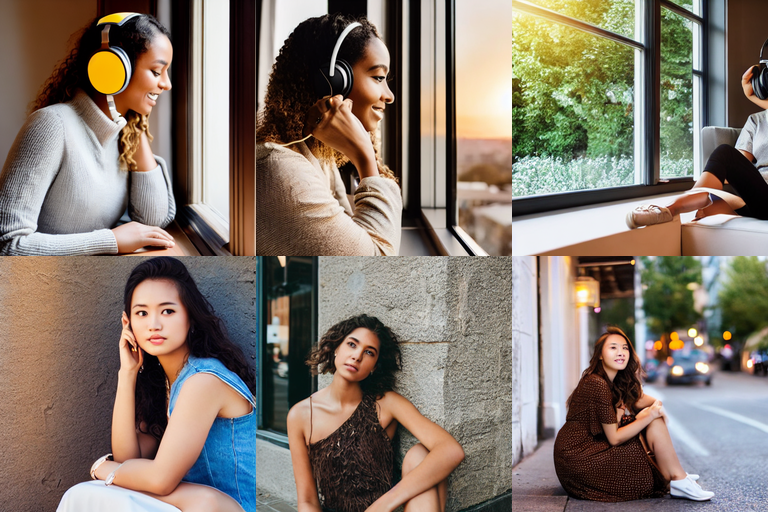

In [23]:
prompt = ["photo of young woman sitting by window with headphones, realistic, golden hour, rim lighting",
          "a young female, highlights in hair, sitting outside restaurant, brown eyes, wearing a dress, side light"]

neg_prompt = ["ugly, deformed, disfigured, bad anatomy"] * len(prompt)
num_imgs = 3

seed = 777
generator = torch.Generator("cuda").manual_seed(seed)

imgs = pipe(prompt,
             num_images_per_prompt=num_imgs,
             negative_prompt = neg_prompt,
             generator=generator).images

grid = grid_img(imgs, rows=len(prompt), cols=num_imgs, scale=0.5)
grid

## Stable Diffusion v2

In [24]:
sd21 = StableDiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-2-1", torch_dtype=torch.float16)

model_index.json:   0%|          | 0.00/537 [00:00<?, ?B/s]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

scheduler/scheduler_config.json:   0%|          | 0.00/345 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/824 [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/633 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/939 [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/611 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.36G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.46G [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

In [25]:
from diffusers import EulerAncestralDiscreteScheduler

sd21.scheduler = EulerAncestralDiscreteScheduler.from_config(sd21.scheduler.config)
print(sd21.scheduler)

sd21 = sd21.to("cuda")
sd21.enable_attention_slicing()

EulerAncestralDiscreteScheduler {
  "_class_name": "EulerAncestralDiscreteScheduler",
  "_diffusers_version": "0.30.0",
  "beta_end": 0.012,
  "beta_schedule": "scaled_linear",
  "beta_start": 0.00085,
  "clip_sample": false,
  "num_train_timesteps": 1000,
  "prediction_type": "v_prediction",
  "rescale_betas_zero_snr": false,
  "set_alpha_to_one": false,
  "skip_prk_steps": true,
  "steps_offset": 1,
  "timestep_spacing": "linspace",
  "trained_betas": null
}



  0%|          | 0/35 [00:00<?, ?it/s]

/tmp/ipykernel_2370/3260908514.py:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w,h), Image.ANTIALIAS)


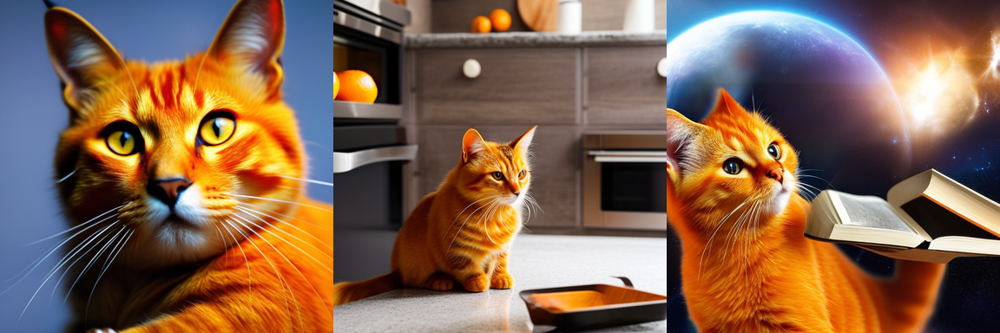

In [26]:
prompt = ["an orange cat ",
          "an orange cat reading a book in the kitchen",
          "an orange cat reading a book in space"]

neg_prompt = ["bad anatomy, ugly, deformed, desfigured, distorted face, poorly drawn hands, poorly drawn face, poorly drawn feet"] * len(prompt)

imgs = sd21(prompt,
          negative_prompt=neg_prompt,
          generator=torch.Generator("cuda").manual_seed(seed),
          num_inference_steps=35).images

grid = grid_img(imgs, rows=1, cols=len(prompt), scale=0.5)
grid

  0%|          | 0/35 [00:00<?, ?it/s]

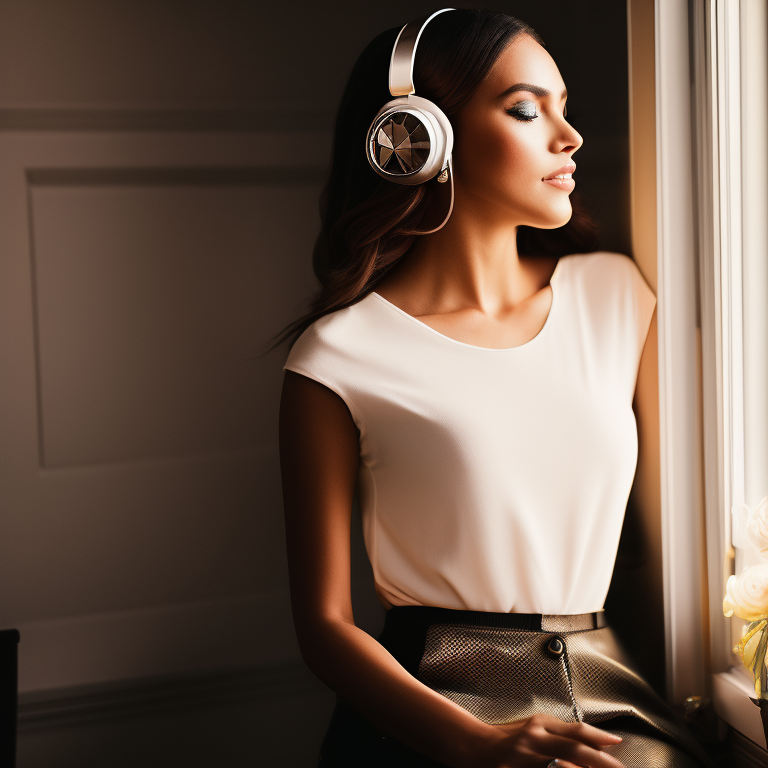

In [27]:
prompt = "photo of young woman sitting by window with headphones, realistic, golden hour, rim lighting"
neg_prompt = "bad anatomy, ugly, deformed, desfigured, distorted face, poorly drawn hands, poorly drawn face, poorly drawn feet"

img = sd21(prompt,
          negative_prompt=neg_prompt,
          generator=torch.Generator("cuda").manual_seed(seed),
          num_inference_steps=35).images[0]
img

  0%|          | 0/35 [00:00<?, ?it/s]

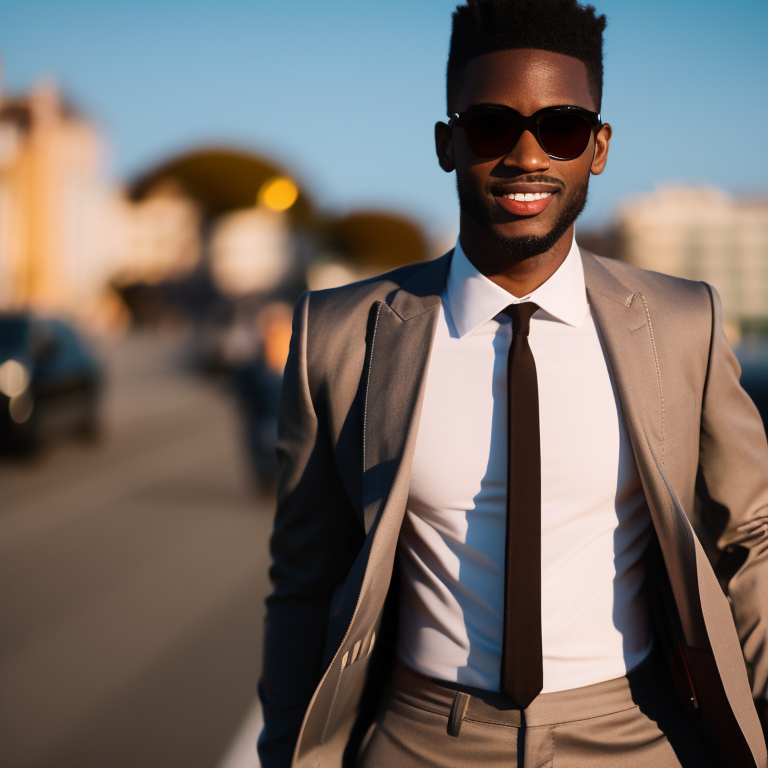

In [28]:
prompt = "a young man in the street, wearing a suit and sunglasses, side light, golden hour"
neg_prompt = "ugly, tiling, closed eyes, poorly drawn hands, poorly drawn feet, poorly drawn face, out of frame, extra limbs, disfigured, deformed, body out of frame, bad anatomy, watermark, signature, cut off, low contrast, underexposed, overexposed, bad art, beginner, amateur, distorted face"

img = sd21(prompt,
          negative_prompt=neg_prompt,
          generator=torch.Generator("cuda").manual_seed(seed),
          num_inference_steps=35).images[0]
img

## Use cases

### Generating arts

  0%|          | 0/35 [00:00<?, ?it/s]

/tmp/ipykernel_2370/3260908514.py:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w,h), Image.ANTIALIAS)


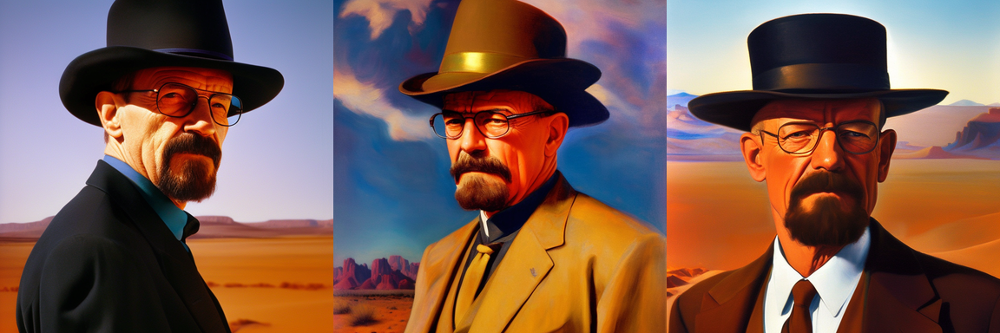

In [29]:
prompt = "oil painting walter white wearing a suit and black hat, by Alphonse Mucha, face portrait, in the desert, realistic, vivid, fantasy, Surrealist"
neg_prompt = "out of frame, out of image, unrealistic, bad anatomy, ugly, deformed, desfigured, distorted face, poorly drawn hands, poorly drawn face, poorly drawn feet"
num_imgs = 3

generator = torch.Generator("cuda").manual_seed(seed)
imgs = sd21(prompt,
             num_images_per_prompt=num_imgs,
             generator=generator,
             negative_prompt = neg_prompt,
             num_inference_steps=35).images

grid = grid_img(imgs, rows=1, cols=num_imgs, scale=0.5)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

/tmp/ipykernel_2370/3260908514.py:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w,h), Image.ANTIALIAS)


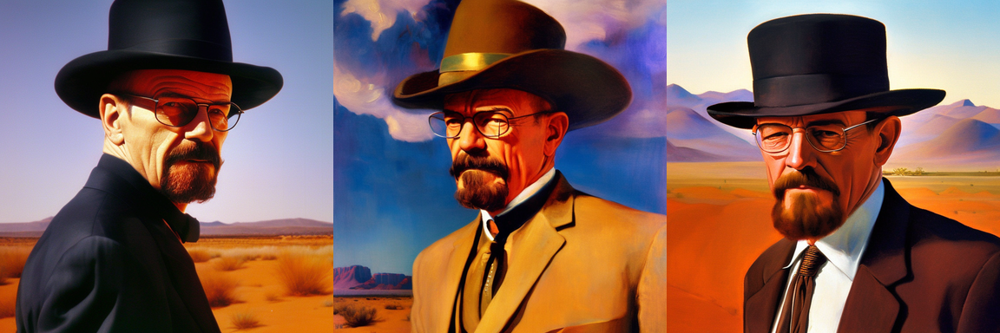

In [30]:
prompt = "oil painting walter white wearing a suit and black hat, by Alphonse Mucha, face portrait, in the desert, realistic, vivid, fantasy, Surrealist"
neg_prompt = "out of frame, out of image, unrealistic, bad anatomy, ugly, deformed, desfigured, distorted face, poorly drawn hands, poorly drawn face, poorly drawn feet"
num_imgs = 3

generator = torch.Generator("cuda").manual_seed(seed)
imgs = sd21(prompt,
             num_images_per_prompt=num_imgs,
             generator=generator,
             negative_prompt = neg_prompt,
             num_inference_steps=50).images

grid = grid_img(imgs, rows=1, cols=num_imgs, scale=0.5)
grid

In [31]:
from diffusers import DDIMScheduler
sd21.scheduler = DDIMScheduler.from_config(sd21.scheduler.config)

In [32]:
from diffusers import EulerAncestralDiscreteScheduler
sd21.scheduler = EulerAncestralDiscreteScheduler.from_config(sd21.scheduler.config)

### Generating photographs

> Tip: you can add keywords related to the digital camera: `35mm`, `85mm`, etc.), ou ainda o plano (o "corte", exemplo: `close-up`, `medium shot`, `full shot`, etc.

  0%|          | 0/35 [00:00<?, ?it/s]

/tmp/ipykernel_2370/3260908514.py:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w,h), Image.ANTIALIAS)


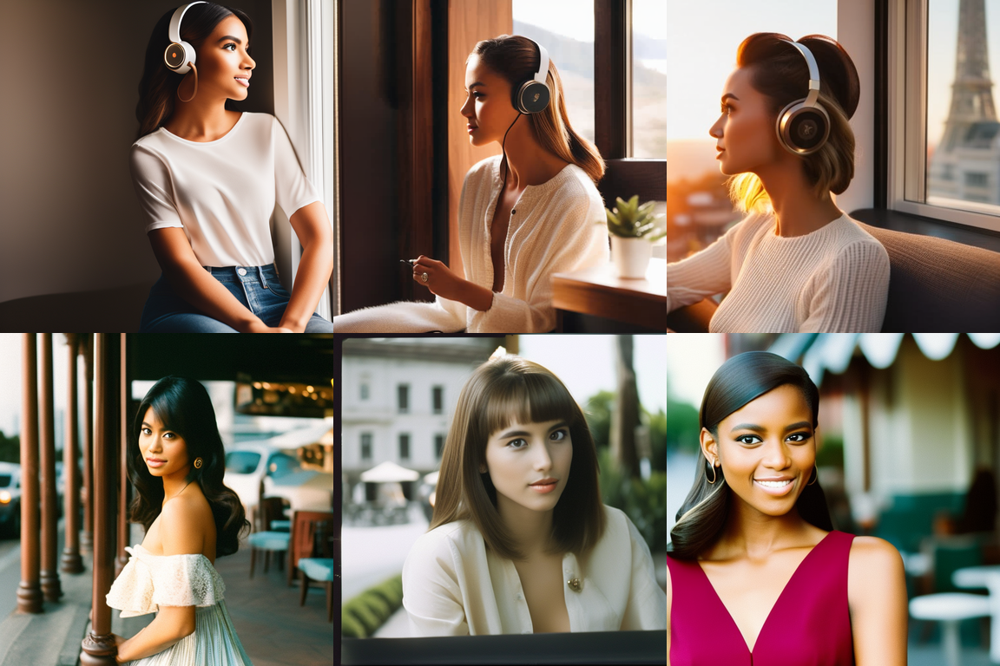

In [33]:
prompt = ["photo of young woman sitting by window with headphones, realistic, golden hour, rim lighting",
          "a young female, highlights in hair, 35mm, medium shot, sitting outside restaurant, brown eyes, wearing a dress, side light"]

neg_prompt = ["ugly, tiling, closed eyes, poorly drawn hands, poorly drawn feet, poorly drawn face, out of frame, extra limbs, disfigured, deformed, body out of frame, bad anatomy, watermark, signature, cut off, low contrast, underexposed, overexposed, bad art, beginner, amateur, distorted face"] * len(prompt)
num_imgs = 3

generator = torch.Generator("cuda").manual_seed(seed)

imgs = sd21(prompt,
             num_images_per_prompt=num_imgs,
             generator=generator,
             negative_prompt = neg_prompt,
             num_inference_steps=35).images

grid = grid_img(imgs, rows=len(prompt), cols=num_imgs, scale=0.5)
grid

### Generating landscapes

  0%|          | 0/35 [00:00<?, ?it/s]

/tmp/ipykernel_2370/3260908514.py:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w,h), Image.ANTIALIAS)


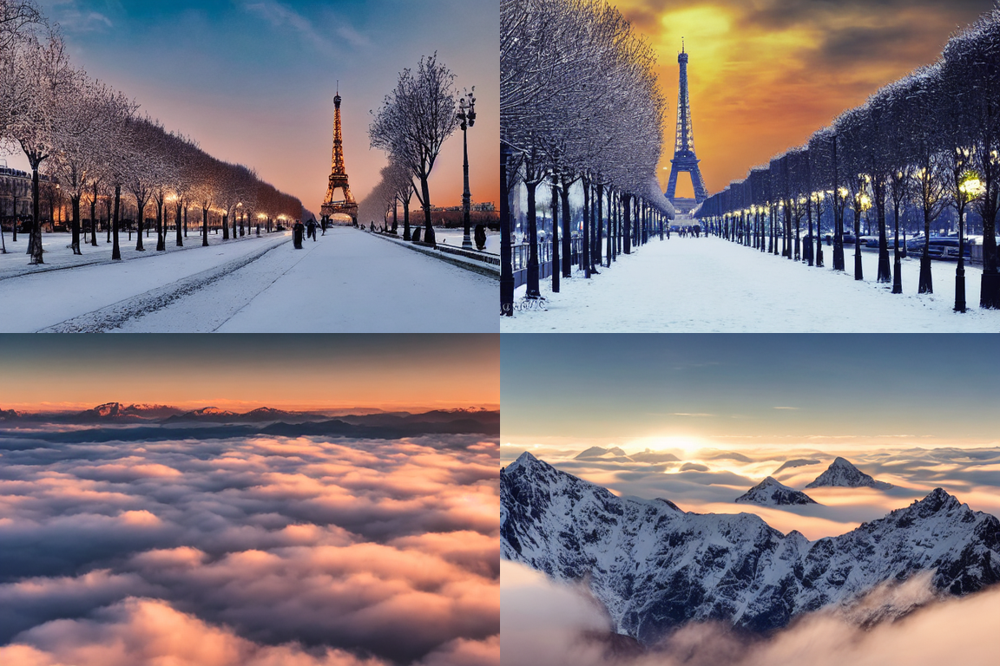

In [34]:
prompt = ["photograph of snow in paris, realistic, landscape, sunset",
          "photograph of a mountain landscape during sunset, above the clouds"]

num_imgs = 2
h, w = 512, 768

generator = torch.Generator("cuda").manual_seed(seed)

imgs = pipe(prompt,
             num_images_per_prompt=num_imgs,
             generator=generator,
             height=h, width=w,
             num_inference_steps=35).images

grid = grid_img(imgs, rows=len(prompt), cols=num_imgs, scale=0.75)
grid

### Generating 3D images


  0%|          | 0/50 [00:00<?, ?it/s]

/tmp/ipykernel_2370/3260908514.py:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w,h), Image.ANTIALIAS)


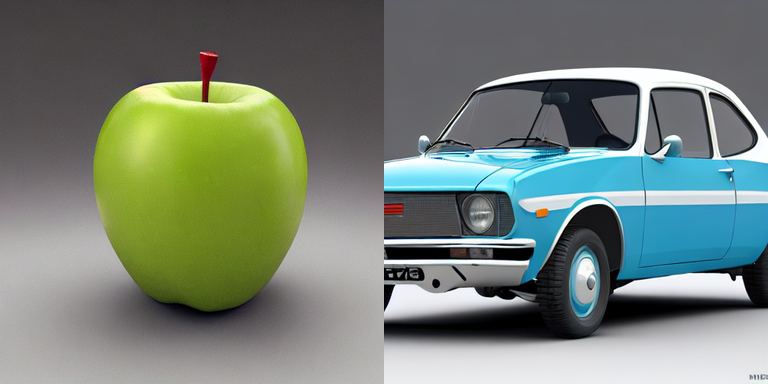

In [35]:
prompt = ["3d rendering of an apple, blender, realistic, highly detailed",
          "old blue chevette, 3d rendering, blender, realistic, highly detailed, 8k, vray"]
neg_prompt = ["ugly, overexposed, not centered, low resolution"] * len(prompt)

generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompt,
             generator=generator,
             negative_prompt=neg_prompt,
             num_inference_steps=50).images

grid = grid_img(imgs, rows=1, cols=len(prompt), scale=0.75)
grid

### Generating drawings

  0%|          | 0/35 [00:00<?, ?it/s]

/tmp/ipykernel_2370/3260908514.py:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w,h), Image.ANTIALIAS)


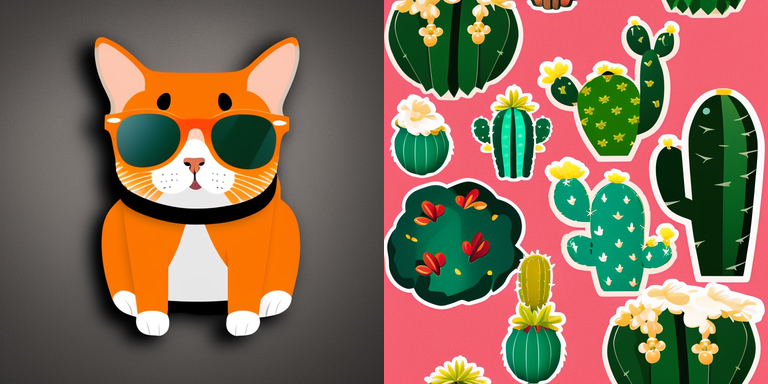

In [36]:
prompt = ["sticker design, an orange cat wearing sunglasses, cute vector, 8K, graphic design, beautiful design",
          "cactus sticker, cute vector, 8K, graphic design"
          ]
neg_prompt = ["bad design, bad drawing, watermark"] * len(prompt)

generator = torch.Generator("cuda").manual_seed(seed)
imgs = sd21(prompt,
             generator=generator,
             negative_prompt = neg_prompt,
             num_inference_steps=35).images

grid = grid_img(imgs, rows=1, cols=len(prompt), scale=0.5)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

/tmp/ipykernel_2370/3260908514.py:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w,h), Image.ANTIALIAS)


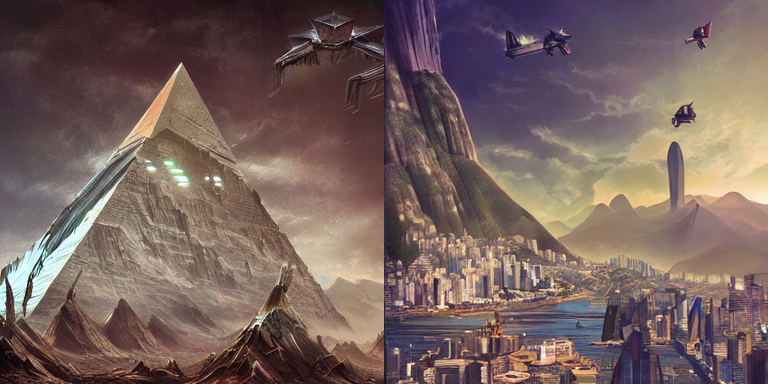

In [37]:
prompt = ["a highly detailed epic cinematic concept art an alien pyramid landscape, art station, landscape, concept art, illustration, highly detailed artwork cinematic, hyper realistic painting",
          "futuristic rio de janeiro, realistic, art station, cinematic, concept art, skyscrapers, landscape, highly detailed artwork"
          ]

generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompt,
             generator=generator,
             num_inference_steps=50).images

grid = grid_img(imgs, rows=1, cols=len(prompt), scale=0.75)
grid

### Generating architectures

  0%|          | 0/35 [00:00<?, ?it/s]

/tmp/ipykernel_2370/3260908514.py:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w,h), Image.ANTIALIAS)


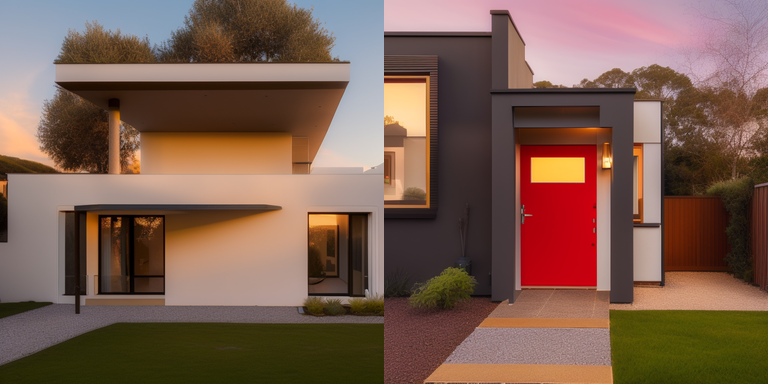

In [38]:
prompt = ["a professional photograph of an italian architectural modern home, soft render, sunset, golden hour",
          "a professional photograph of an modern house, red door, soft render, golden hour"]

neg_prompt = ["watermark"] * len(prompt)

generator = torch.Generator("cuda").manual_seed(seed)
imgs = sd21(prompt,
             generator=generator,
             negative_prompt = neg_prompt,
             num_inference_steps=35).images

grid = grid_img(imgs, rows=1, cols=len(prompt), scale=0.5)
grid

## Improving the results using custom models

* Also called as fine-tuned models.
* Depending on the model chosen, it may generate inappropriate images if certain words are chosen. In this case they are classified as NSFW (*not safe for work*) and as a result a black image is returned. Therefore, if you want to disable it (at your onw risk) you can add the following: `pipe.safety_checker = None`. In those cases, if the model has this bias it may be necessary to put terms like `naked` in the negative prompt.

### Some models

* **Anything** (`cag/anything-v3-1`) - Anime and comics style images, often used to generate new characters.
 * https://huggingface.co/cag/anything-v3-1

* **DreamShaper** (`Lykon/DreamShaper`) - A "mix" model that encompasses various styles, from photorealism to anime and specific illustration styles.
 * https://huggingface.co/Lykon/DreamShaper

* **Realistic Vision** (`SG161222/Realistic_Vision_V1.4`) - focus on photorealism, high degree of realism and definition to images that simulate professional photographs.
 * https://huggingface.co/SG161222/Realistic_Vision_V1.4

* **Analog Diffusion** (`wavymulder/Analog-Diffusion`) -
Model trained with dreambooth, using a dataset of analog photographs. The generated images will have that aspect of analogue photography and film.
 * https://huggingface.co/wavymulder/Analog-Diffusion

* **Protogen** (`darkstorm2150/Protogen_x3.4_Official_Release`) - encompasses several styles, but it is mostly used to simulate degrees of realism.
 * https://huggingface.co/darkstorm2150/Protogen_x3.4_Official_Release

* **Mitsua Diffusion One** (`Mitsua/mitsua-diffusion-one`) - The most "ethical" model possible as it is under the CC0 license (safe to use). It is a model that is more concerned with this issue, so all data for training was obtained in accordance with the terms and conditions of its authors.
 * https://huggingface.co/Mitsua/mitsua-diffusion-one


> More and more models here: https://huggingface.co/models?library=diffusers



> **Anything v3.1** (cag/anything-v3-1)

In [39]:
from diffusers import DPMSolverMultistepScheduler

seed = 777
anything = StableDiffusionPipeline.from_pretrained("cag/anything-v3-1", torch_dtype=torch.float16)
anything = anything.to("cuda")
anything.enable_attention_slicing()
anything.scheduler = DPMSolverMultistepScheduler.from_config(anything.scheduler.config)

model_index.json:   0%|          | 0.00/511 [00:00<?, ?B/s]

safety_checker/model.safetensors not found


Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

safety_checker/config.json:   0%|          | 0.00/4.55k [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/341 [00:00<?, ?B/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/807 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/548 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/901 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/492M [00:00<?, ?B/s]

diffusion_pytorch_model.bin:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

diffusion_pytorch_model.bin:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

An error occurred while trying to fetch /home/jovyan/.cache/huggingface/hub/models--cag--anything-v3-1/snapshots/907b769ec43b228c9943b4df5ea193d6e885f840/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /home/jovyan/.cache/huggingface/hub/models--cag--anything-v3-1/snapshots/907b769ec43b228c9943b4df5ea193d6e885f840/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /home/jovyan/.cache/huggingface/hub/models--cag--anything-v3-1/snapshots/907b769ec43b228c9943b4df5ea193d6e885f840/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /home/jovyan/.cache/huggingface/hub/models--cag--anything-v3-1/snapshots/907b769ec43b228c9943b4df5ea193d6e885f840/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


  0%|          | 0/50 [00:00<?, ?it/s]

/tmp/ipykernel_2370/3260908514.py:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w,h), Image.ANTIALIAS)


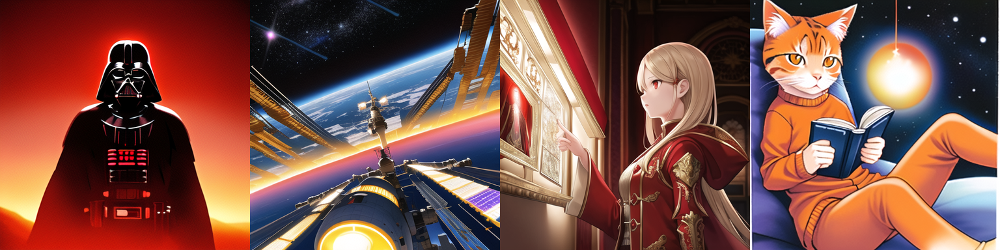

In [40]:
prompt = ["darth vader in the desert, medium shot, cinematic, red tones, masterpiece, best quality, illustration, beautiful detailed, finely detailed, dramatic light, intricate details",
          "space station orbiting earth, medium shot, colorful, masterpiece, best quality, illustration, beautiful detailed, finely detailed, dramatic light, intricate details",
          "female wizard wearing a red coat, medium shot, masterpiece, best quality, illustration, beautiful detailed, finely detailed, dramatic light, intricate details",
          "an orange cat reading a book in space"]

neg_prompt = ["bad drawing, watermark, poorly drawn hands"] * len(prompt)

generator = torch.Generator("cuda").manual_seed(seed)
anything.safety_checker = None
imgs = anything(prompt,
          negative_prompt=neg_prompt,
          generator=generator,
          guidance_scale=12,
          num_inference_steps=50).images

grid = grid_img(imgs, rows=1, cols=len(prompt), scale=0.75)
grid

> **Protogen** (`darkstorm2150/Protogen_x3.4_Official_Release`)

In [41]:
from diffusers import DPMSolverMultistepScheduler

protogen = StableDiffusionPipeline.from_pretrained("darkstorm2150/Protogen_x3.4_Official_Release", torch_dtype=torch.float16)
protogen = protogen.to("cuda")
protogen.enable_attention_slicing()
protogen.scheduler = DPMSolverMultistepScheduler.from_config(protogen.scheduler.config)

model_index.json:   0%|          | 0.00/582 [00:00<?, ?B/s]

text_encoder/model.safetensors not found


Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

safety_checker/config.json:   0%|          | 0.00/4.91k [00:00<?, ?B/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/520 [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/346 [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/582 [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/1.02k [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/492M [00:00<?, ?B/s]

diffusion_pytorch_model.bin:   0%|          | 0.00/335M [00:00<?, ?B/s]

diffusion_pytorch_model.bin:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /home/jovyan/.cache/huggingface/hub/models--darkstorm2150--Protogen_x3.4_Official_Release/snapshots/f2e5e212b41ddc7a71a5972346c6b0978bf7b7a2/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /home/jovyan/.cache/huggingface/hub/models--darkstorm2150--Protogen_x3.4_Official_Release/snapshots/f2e5e212b41ddc7a71a5972346c6b0978bf7b7a2/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /home/jovyan/.cache/huggingface/hub/models--darkstorm2150--Protogen_x3.4_Official_Release/snapshots/f2e5e212b41ddc7a71a5972346c6b0978bf7b7a2/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /home/jovyan/.cache/huggingface/hub/models--darkstorm2150--Protogen_x3.4_Official_Release/snapshots/f2e5e212b41ddc7a71a5972346c6b0978bf7b7a2/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


  0%|          | 0/25 [00:00<?, ?it/s]

/tmp/ipykernel_2370/3260908514.py:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w,h), Image.ANTIALIAS)


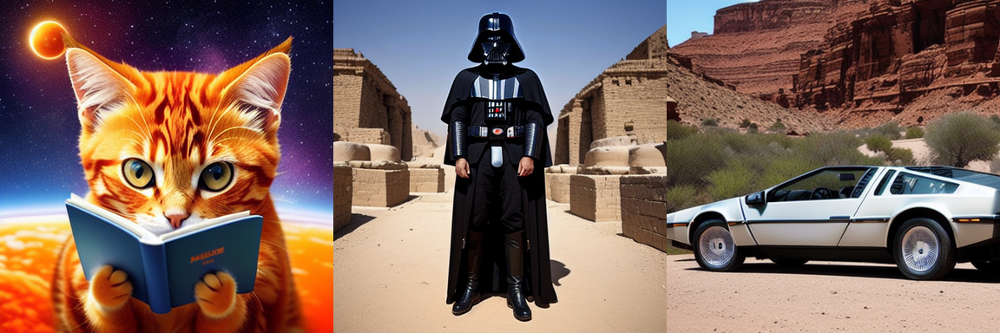

In [42]:
prompt = ["orange cat reading a book in space",
          "darth vader in ancient egypt, medium shot",
          "photo of a delorean in the canyons"]

neg_prompt = ["bad anatomy, ugly, deformed, desfigured, distorted face, poorly drawn hands, poorly drawn face, poorly drawn feet"] * len(prompt)

generator = torch.Generator("cuda").manual_seed(seed)
protogen.safety_checker = None
imgs = protogen(prompt,
          negative_prompt=neg_prompt,
          generator=generator,
          num_inference_steps=25).images

grid = grid_img(imgs, rows=1, cols=len(prompt), scale=0.75)
grid


> **Analog-Diffusion** (wavymulder/Analog-Diffusion)


In [43]:
from diffusers import EulerAncestralDiscreteScheduler

ad = StableDiffusionPipeline.from_pretrained("wavymulder/Analog-Diffusion", torch_dtype=torch.float16)
ad = ad.to("cuda")
ad.enable_attention_slicing()
ad.scheduler = EulerAncestralDiscreteScheduler.from_config(ad.scheduler.config)

model_index.json:   0%|          | 0.00/582 [00:00<?, ?B/s]

text_encoder/model.safetensors not found


Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

text_encoder/config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/518 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/346 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

safety_checker/config.json:   0%|          | 0.00/4.91k [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/877 [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/582 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/492M [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

diffusion_pytorch_model.bin:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

diffusion_pytorch_model.bin:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /home/jovyan/.cache/huggingface/hub/models--wavymulder--Analog-Diffusion/snapshots/211449c273875dedc683fdb5a95d8a0ff9d76484/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /home/jovyan/.cache/huggingface/hub/models--wavymulder--Analog-Diffusion/snapshots/211449c273875dedc683fdb5a95d8a0ff9d76484/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /home/jovyan/.cache/huggingface/hub/models--wavymulder--Analog-Diffusion/snapshots/211449c273875dedc683fdb5a95d8a0ff9d76484/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /home/jovyan/.cache/huggingface/hub/models--wavymulder--Analog-Diffusion/snapshots/211449c273875dedc683fdb5a95d8a0ff9d76484/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


  0%|          | 0/35 [00:00<?, ?it/s]

/tmp/ipykernel_2370/3260908514.py:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w,h), Image.ANTIALIAS)


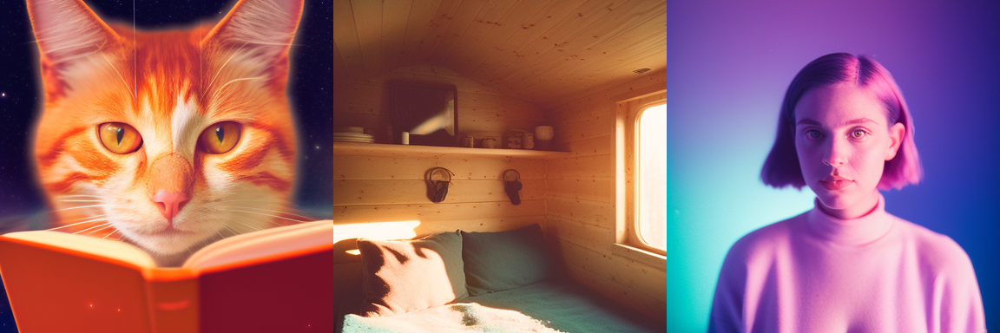

In [44]:
prompt = ["analog style orange cat reading a book in space",
          "analog style cozy comfy cabin interior",
          "analog style portrait of a girl, purple and blue lights"]

neg_prompt = [""] * 3

generator = torch.Generator("cuda").manual_seed(seed)
ad.safety_checker = None
imgs = ad(prompt,
          negative_prompt=neg_prompt,
          generator=generator,
          num_inference_steps=35).images

grid = grid_img(imgs, rows=1, cols=len(prompt), scale=0.75)
grid

**DreamShaper** (`Lykon/DreamShaper`)
 * or, you can use `jzli/DreamShaper-3.3` instead.


In [45]:
from diffusers import EulerAncestralDiscreteScheduler

ds = StableDiffusionPipeline.from_pretrained("Lykon/DreamShaper", torch_dtype=torch.float16)
ds = ds.to("cuda")
ds.enable_attention_slicing()
ds.scheduler = EulerAncestralDiscreteScheduler.from_config(ds.scheduler.config)

model_index.json:   0%|          | 0.00/579 [00:00<?, ?B/s]

text_encoder/model.safetensors not found


Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/520 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

safety_checker/config.json:   0%|          | 0.00/4.58k [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/528 [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/577 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/492M [00:00<?, ?B/s]

diffusion_pytorch_model.bin:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/1.58k [00:00<?, ?B/s]

diffusion_pytorch_model.bin:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /home/jovyan/.cache/huggingface/hub/models--Lykon--DreamShaper/snapshots/228d79cb20811466f5c5710aa91f05dabd0b8a14/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /home/jovyan/.cache/huggingface/hub/models--Lykon--DreamShaper/snapshots/228d79cb20811466f5c5710aa91f05dabd0b8a14/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
/opt/conda/lib/python3.10/site-packages/transformers/models/clip/feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(
An error occurred while trying to fetch /home/jovyan/.cache/huggingface/hub/models--Lykon--DreamShaper/snapshots/228d79cb20811466f5c5710aa91f05dabd0b8a14/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /home/jovyan/.cache/huggingface/hub/models--Lykon--DreamShap

  0%|          | 0/35 [00:00<?, ?it/s]

/tmp/ipykernel_2370/3260908514.py:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w,h), Image.ANTIALIAS)


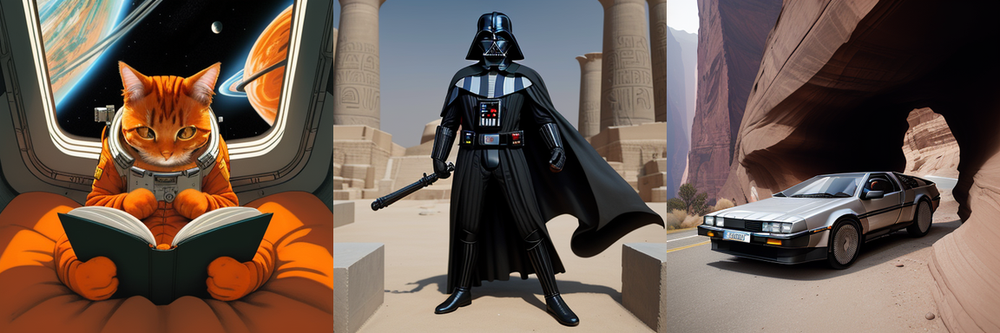

In [46]:
prompt = ["analog style orange cat reading a book in space",
          "darth vader in ancient egypt, medium shot",
          "photo of a delorean in the canyons"]

neg_prompt = [""] * 3

generator = torch.Generator("cuda").manual_seed(seed)
ds.safety_checker = None
imgs = ds(prompt,
          negative_prompt=neg_prompt,
          generator=generator,
          num_inference_steps=35).images

grid = grid_img(imgs, rows=1, cols=len(prompt), scale=0.75)
grid

> **Realistic Vision** (`SG161222/Realistic_Vision_V1.4`)

* Recommended keywords: `8k uhd, dslr, soft lighting, high quality, film grain, Fujifilm XT3`.

In [47]:
from diffusers import EulerAncestralDiscreteScheduler

ds = StableDiffusionPipeline.from_pretrained("SG161222/Realistic_Vision_V1.4", torch_dtype=torch.float16)
ds = ds.to("cuda")
ds.enable_attention_slicing()
ds.scheduler = EulerAncestralDiscreteScheduler.from_config(ds.scheduler.config)

model_index.json:   0%|          | 0.00/577 [00:00<?, ?B/s]

text_encoder/model.safetensors not found


Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

scheduler/scheduler_config.json:   0%|          | 0.00/341 [00:00<?, ?B/s]

safety_checker/config.json:   0%|          | 0.00/4.89k [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/518 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/492M [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/901 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/548 [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

diffusion_pytorch_model.bin:   0%|          | 0.00/335M [00:00<?, ?B/s]

diffusion_pytorch_model.bin:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /home/jovyan/.cache/huggingface/hub/models--SG161222--Realistic_Vision_V1.4/snapshots/686d3dcb8bbc7e6a7757fd161e0fbafd23d6c629/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /home/jovyan/.cache/huggingface/hub/models--SG161222--Realistic_Vision_V1.4/snapshots/686d3dcb8bbc7e6a7757fd161e0fbafd23d6c629/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /home/jovyan/.cache/huggingface/hub/models--SG161222--Realistic_Vision_V1.4/snapshots/686d3dcb8bbc7e6a7757fd161e0fbafd23d6c629/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /home/jovyan/.cache/huggingface/hub/models--SG161222--Realistic_Vision_V1.4/snapshots/686d3dcb8bbc7e6a7757fd161e0fbafd23d6c629/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


  0%|          | 0/35 [00:00<?, ?it/s]

/tmp/ipykernel_2370/3260908514.py:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w,h), Image.ANTIALIAS)


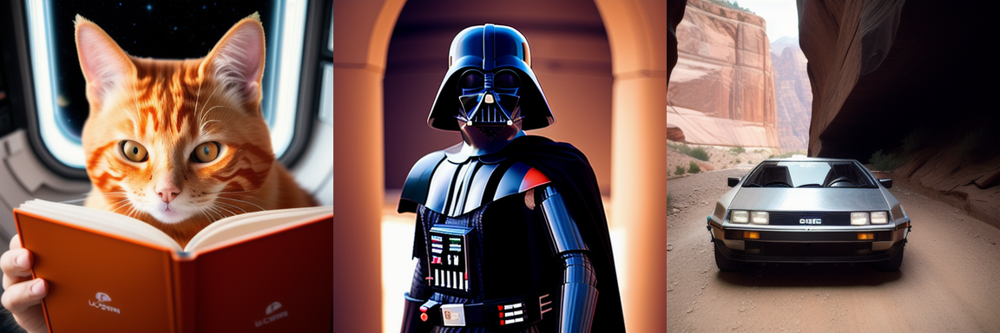

In [48]:
prompt = ["orange cat reading a book in space, 8k uhd, dslr, soft lighting, high quality, film grain, Fujifilm XT3",
          "darth vader in ancient egypt, 8k uhd, dslr, soft lighting, high quality, film grain, Fujifilm XT3",
          "delorean in the canyons, 8k uhd, dslr, soft lighting, high quality, film grain, Fujifilm XT3"]

neg_prompt = [""] * 3

generator = torch.Generator("cuda").manual_seed(seed)
ds.safety_checker = None
imgs = ds(prompt,
          negative_prompt=neg_prompt,
          generator=generator,
          num_inference_steps=35).images

grid = grid_img(imgs, rows=1, cols=len(prompt), scale=0.75)
grid